In [18]:
import geopandas as gpd
import pandas as pd
import json
import plotly.graph_objects as go
import urllib.request

from shapely.geometry import LineString, MultiLineString

In [19]:
df= pd.read_csv('data/O3_por_ageb.csv')

In [3]:
df.head()

,id,O3_anual_f
0,5171,37.820261
1,3337,37.820261
2,4280,37.671950
3,7494,37.671950
4,3024,37.820261


In [4]:
geodf= gpd.read_file('data/O3_ageb.shp')

In [5]:
geodf.dtypes

id              int64
O3_anual_f    float64
geometry       object
dtype: object

In [6]:
geodf.head()

,id,O3_anual_f,geometry
0,16946,36.005067,POLYGON ((-98.96482026691865 19.21442578890746...
1,17354,36.005067,POLYGON ((-98.95156061567165 19.21442578890746...
2,4199,36.005067,POLYGON ((-98.95948159243605 19.21442578890746...
3,1621,36.005067,POLYGON ((-98.95795433499778 19.21442578890746...
4,29615,36.005067,POLYGON ((-98.95999687941416 19.21442578890746...


In [7]:
geodf.to_file('data/o3_ageb.json', driver= 'GeoJSON')
with open ('data/o3_ageb.json') as geofile:
    j_file=json.load(geofile)

In [8]:
def check_geojson(j_file):
    if 'id' not in j_file['features'][0].keys():
        if 'properties' in j_file['features'][0].keys():
            if 'id' in j_file['features'][0]['properties'] and j_file['features'][0]['properties']['id'] is not None:
                for k, feat in enumerate(j_file['features']):
                    j_file['features'][k]['id']= feat['properties']['id']
            else:
                for k in range(len(j_file['features'])):
                    j_file['features'][k]['id']= k
    return j_file

In [9]:
jdata= check_geojson(j_file)

In [10]:
jdata['type']

'FeatureCollection'

In [11]:
jdata['features'][0].keys()

dict_keys(['type', 'properties', 'geometry', 'id'])

In [12]:
jdata['features'][7]['properties']

{'id': 7599, 'O3_anual_f': 36.005067}

In [13]:
z= geodf.O3_anual_f

In [14]:
trace = go.Choroplethmapbox(z=z,
                            locations=geodf.id,
                            colorscale='Viridis',
                            colorbar=dict(thickness=20, ticklen=3),
                            geojson=jdata,
                            hoverinfo= 'all',
                            marker_line_width=0.1, marker_opacity=0.5)

In [15]:
layout= go.Layout(title_text= 'Choroplethmapbox',
                   title_x=0.5, width = 700, height=700,
                   mapbox = dict(center= dict(lat=19.4284706,  lon=-99.1276627),
                                 style= 'carto-positron',
                                 zoom=11,
                               ))

In [16]:
fig= go.Figure(data=[trace], layout=layout)
fig.update_layout(mapbox_style= 'carto-positron')
fig.show()

In [17]:
geodf.loc[geodf['id'] == 21136]

,id,O3_anual_f,geometry
3894,21136,30.083696,POLYGON ((-99.12967805539408 19.43052784407674...


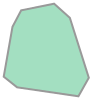

In [17]:
geodf.loc[geodf['id'] == 21136, 'geometry'].iloc[0]

In [21]:
df2= pd.read_csv('/home/pradel/Desktop/ecobici_viz/data/contaminacion/contaminacion_por_ageb/contaminacion_O3_ageb.csv')

In [22]:
df2.head()

,Longitud,Latitud,CVE_AGEB,O3_por_ageb_0,O3_por_ageb_1,O3_por_ageb_7,O3_por_ageb_8,O3_por_ageb_9,O3_por_ageb_10,O3_por_ageb_11,...,O3_por_ageb_14,O3_por_ageb_15,O3_por_ageb_16,O3_por_ageb_17,O3_por_ageb_18,O3_por_ageb_19,O3_por_ageb_20,O3_por_ageb_21,O3_por_ageb_22,O3_por_ageb_23
0,-99.267061,19.651464,1142,13.628122,13.209581,3.833883,5.703524,12.004048,22.006814,35.477689,...,67.041504,67.668759,63.324419,55.104068,43.386110,30.757318,23.045932,18.905021,16.015706,14.297780
1,-98.954127,19.254488,1012,15.511295,14.751738,6.903726,8.597841,15.454088,26.431057,39.413621,...,70.816001,71.515558,67.634140,60.537320,50.311341,38.551757,30.031322,24.231629,19.879235,16.915637
2,-98.941566,19.649080,0393,13.115604,12.076184,3.374328,5.427114,12.038293,23.086096,36.923900,...,65.035937,64.816628,60.679129,53.267998,42.936391,31.701032,24.494514,20.165159,16.789342,14.433675
3,-99.390848,19.505639,003A,17.253947,17.067075,8.171560,9.424596,15.094111,24.229211,36.287788,...,68.266740,69.977465,66.455069,58.558184,46.959615,34.653979,26.763062,22.115811,19.078020,17.668616
4,-98.870761,19.151455,0037,17.721331,17.080992,8.995739,10.402019,16.988530,27.749670,40.549154,...,71.890517,73.121805,69.666211,62.810922,52.641014,41.128308,32.567274,26.428712,21.838155,18.962812
